In [1]:
from GG_mthesis import *
import metpy
import metpy.calc as mpcalc
from metpy.cbook import get_test_data
from metpy.units import units
%matplotlib inline

sns.set_style('whitegrid')
sns.set_palette('colorblind')
sns.set(font_scale=1.2)

#OBSOLETE, TO MUCH LOOPING AND NO DASK. KEEPING IT FOR FUTURE REFERENCES. SHOULD BE FINE WITH NETCDF READER

#Start year and end year
START_YEAR  = 2017
END_YEAR    = 2018 #NOT INCLUDED

#Input paths of the files
base_adt_path = 'data/AVISO/dataset-duacs-rep-global-merged-twosat-phy-l4/' #
adt_file_name_base = 'dt_global_twosat_phy_l4_'

base_mdt_path = 'data/AVISO/'
mdt_file_name = 'mdt-cnes-cls18-global.nc'

#Empty datatsets list where each dataset is going to be appended to. Also the years, months days to be looped over
datasets = []
years = range(START_YEAR, END_YEAR)
months = ['%.2d' % i for i in range(1,13)]
days = ['%.2d' % i for i in range(1,32)]
import itertools
for i_year, i_month, i_day in itertools.product(years, months, days): #itertools.product is like nested loops but in less lines
    try:
        datasets.append(xr.open_dataset(base_adt_path + str(i_year) + '/' + i_month + '/' + adt_file_name_base + str(i_year) + i_month + i_day + '_vDT2018.nc').sel(latitude=slice(-90,-30)).drop_vars(['ugos','vgos','ugosa','vgosa','err', 'crs'])) #slicing and dropping variables optional for memory issues
    except:
        continue

ds = xr.concat(datasets, dim='time') #This puts all the datasets in just one datasets. Here memory plays a role.

ds = ds.assign_coords(longitude=(((ds.longitude + 180) % 360) - 180)).sortby('longitude')
ds['lon_bnds'] = (['time', 'longitude', 'nv'], np.sort(((ds.lon_bnds + 180) % 360) - 180))
ds.longitude.attrs = {'axis': 'X',
'bounds': 'lon_bnds', 
'long_name': 'Longitude',
'standard_name': 'longitude',
'units': 'degrees',
'valid_max': float(ds.longitude.max()),
'valid_min': float(ds.longitude.min())}

ds.lon_bnds.attrs = {'comment': 'longitude values at the west and east bounds of each pixel.',
 'units': 'degrees'}

ds_adt = ds

In [2]:
25 * units('m/(100 km)')

0.25 <Unit('meter / kilometer')>

In [3]:
#Start year and end year
START_YEAR  = 2017
END_YEAR    = 2018 #NOT INCLUDED

years = range(START_YEAR, END_YEAR)
months = ['%.2d' % i for i in range(1,13)]
#Input paths of the files
base_adt_path = 'data/AVISO/dataset-duacs-rep-global-merged-twosat-phy-l4/' #
adt_file_name_base = 'dt_global_twosat_phy_l4_'

base_mdt_path = 'data/AVISO/'
mdt_file_name = 'mdt-cnes-cls18-global.nc'


#Main file reading algorithm. Multifile reader of xarray which concanates the read files (loading through dask). Additional loop and concanating of each month and years (THIS IS JUST FOR THE FIRST YEAR, CHANGE INDEX OF YEARS (MAY HAVE TO LOOP THROUGH))
ds_adt = xr.concat([[xr.open_mfdataset(base_adt_path + str(i_year) + '/' + i_month + '/' + '*.nc', parallel = True) for i_month in months] for i_year in years][0], dim='time')

#To change longitude format from 0:360 to -180:180. REMOVES DASK PARTIONING FROM LONGITUDE. (skip it for now)
#ds_adt = ds_adt.assign_coords(longitude=(((ds_adt.longitude + 180) % 360) - 180)).sortby('longitude')
#ds_adt['lon_bnds'] = (['time', 'longitude', 'nv'], np.sort(((ds_adt.lon_bnds + 180) % 360) - 180))
#ds_adt.longitude.attrs = {'axis': 'X',
#'bounds': 'lon_bnds', 
#'long_name': 'Longitude',
#'standard_name': 'longitude',
#'units': 'degrees',
#'valid_max': float(ds_adt.longitude.max()),
#'valid_min': float(ds_adt.longitude.min())}

#ds_adt.lon_bnds.attrs = {'comment': 'longitude values at the west and east bounds of each pixel.',
# 'units': 'degrees'}

In [4]:
#MDT

#Input paths of files 
base_mdt_path   = 'data/AVISO/'
mdt_file_name   = 'mdt-cnes-cls18-global.nc'

#Load the date and change longitude format
ds_mdt = xr.load_dataset(base_mdt_path + mdt_file_name)
#ds_mdt = ds_mdt.assign_coords(longitude=(((ds_mdt.longitude + 180) % 360) - 180)).sortby('longitude')
#ds_mdt.longitude.attrs = {'long_name': 'Longitude',
# 'standard_name': 'longitude',
# 'units': 'degrees_east',
# 'bounds': 'lon_bnds',
# 'axis': 'X',
# 'valid_min': float(ds_mdt.longitude.min()),
# 'valid_max': float(ds_mdt.longitude.max()),
# '_CoordinateAxisType': 'Lon'}

#Interpolate to sla raster.
ds_mdt = ds_mdt.interp(longitude = ds_adt.longitude, latitude = ds_adt.latitude).transpose('time','latitude','longitude')

In [5]:
#Calculates the ADT as the sum of MDT and SLA
ds_adt['adt_calc'] = ds_adt.sla + ds_mdt.mdt.isel(time=0)

ds_adt.adt_calc.attrs = {'comment': 'The absolute dynamic topography is the sea surface height above geoid; the adt is obtained as follows: adt=sla+mdt where mdt is the mean dynamic topography; calculated in this script',
 'grid_mapping': 'crs',
 'long_name': 'Absolute dynamic topography',
 'standard_name': 'sea_surface_height_above_geoid',
 'units': 'm'}

In [6]:
ds_adt = ds_adt.metpy.quantify() #sets the units in the dataset
ds_adt_SO = ds_adt.sel(latitude = slice(-70,-40)) #select the southern ocean regionally

In [7]:
#calculate the SSH gradient (in m/km)
ds_adt_SO['adt_grad_mer'] = (mpcalc.gradient(ds_adt_SO.adt, axes=['latitude']))[0]*units('m/m').to('m/km')

In [8]:
#Ant the SSH gradient calculated with the SSH here
ds_adt_SO['adt_grad_mer_calc'] = (mpcalc.gradient(ds_adt_SO.adt_calc, axes=['latitude']))[0]*units('m/m').to('m/km')

In [9]:
#The transect longitude in degrees east
display(str('Transect longitude = ')+ str(((-57.66935751 - 180) % 360) + 180))

'Transect longitude = 302.33064249'

In [10]:
utils.utils.closest_value(ds_adt.longitude, 302.33064249)

302.375

In [11]:
#Here I select a latitudinal line (fix longitude) at the mean longitude of the ORCHESTRA cruise (-57.66935751)
ds_adt_drake_transect = ds_adt_SO.sel(longitude = utils.utils.closest_value(ds_adt.longitude, 302.33064249))

In [12]:
#This algorithm calculates the presence or not presence of a gradient values greater the the threshold
gradient_threshold = 0.25
front_loc = (ds_adt_drake_transect['latitude'].where(np.abs((ds_adt_drake_transect.adt_grad_mer*100).metpy.dequantify()) >= gradient_threshold)).fillna(0).astype(bool).transpose('time','latitude')
front_loc = front_loc.where(front_loc == True)

In [13]:
ds_adt_drake_transect

<xarray.Dataset>
Dimensions:            (latitude: 120, nv: 2, time: 365)
Coordinates:
  * time               (time) datetime64[ns] 2017-01-01 ... 2017-12-31
  * latitude           (latitude) float32 -69.88 -69.62 -69.38 ... -40.38 -40.12
  * nv                 (nv) int32 0 1
    longitude          float32 302.4
Data variables: (12/13)
    crs                (time) int32 <Quantity([-2147483647 -2147483647 -21474...
    lat_bnds           (time, latitude, nv) float32 <Quantity(dask.array<geti...
    lon_bnds           (time, nv) float32 <Quantity(dask.array<getitem, shape...
    err                (time, latitude) float64 <Quantity(dask.array<getitem,...
    adt                (time, latitude) float64 <Quantity(dask.array<getitem,...
    ugos               (time, latitude) float64 <Quantity(dask.array<getitem,...
    ...                 ...
    sla                (time, latitude) float64 <Quantity(dask.array<getitem,...
    ugosa              (time, latitude) float64 <Quantity(dask.array<getitem,...
    vgosa              (time, latitude) float64 <Quantity(dask.array<getitem,...
    adt_calc           (time, latitude) float64 <Quantity(dask.array<getitem,...
    adt_grad_mer       (time, latitude) float64 <Quantity([[            nan  ...
    adt_grad_mer_calc  (time, latitude) float64 <Quantity([[            nan  ...

#Again irrelevant though kind of cool. Keeping it for later references

import itertools
front_loc = []
counter = 0
for i_day, i_lat in itertools.product(range(len(adt_dif_drake)), range(len(adt_dif_drake[0]))):
    counter = counter + 1
    print(str(counter) + ' of ' + str(len(adt_dif_drake)*len(adt_dif_drake[0])))
    if float(adt_dif_drake[i_day][i_lat]) >= 0.1:
        front_loc.append(float(adt_dif_drake[i_day][i_lat].longitude))
    else:
        front_loc.append(np.nan)

<ipython-input-14-e4e48112108c>:53: UserWarning: The following kwargs were not used by contour: 'yincrease', 'add_colorbar'
  fronts = ax2.contourf(front_loc.latitude, np.array(front_loc.time), front_loc,


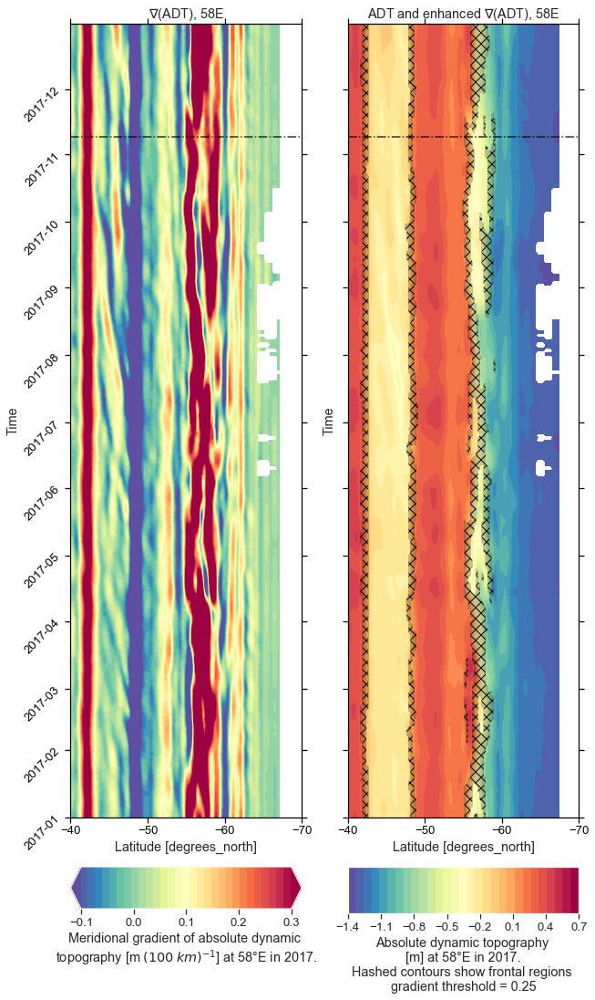

In [14]:
#Hovmoller plot at the longitude

import matplotlib.ticker as ticker
import cmocean as cm

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,20))

contour1 = (ds_adt_drake_transect.adt_grad_mer*100).plot.contourf(cmap='Spectral_r', 
    levels=30, 
    yincrease=True, 
    center=0.1, 
    vmin=-0.1, 
    add_colorbar= False, 
    extend='both', 
    ax=ax1)
cbar1 = fig.colorbar(contour1, 
    orientation='horizontal', 
    ticks=[-0.2,-0.1,0.0,0.1,0.2,0.3], 
    aspect=5, 
    pad=0.05, 
    label='Meridional gradient of absolute dynamic \ntopography [m $(100\:km)^{-1}$] at 58°E in 2017.',
    ax=ax1)
ax1.axhline(np.datetime64('2017-11-09T00:00:00.000000000'), 
    linestyle='-.', 
    c='black', 
    alpha=0.8)
ax1.set_title(r'$\nabla$(ADT), 58E')
ax1.set_xlim(ax1.get_xlim()[::-1])
ax1.set_xticks([-40,-50,-60,-70])
ax1.tick_params(reset=True, 
    axis='both', 
    colors='black', 
    direction='out')
for tick in ax1.get_yticklabels():
    tick.set_rotation(45)
ax1.set_facecolor('white')
ax1.spines['top'].set_color('black')
ax1.spines['right'].set_color('black')
ax1.spines['bottom'].set_color('black')
ax1.spines['left'].set_color('black')

contour2 = ds_adt_drake_transect.adt.plot.contourf(cmap='Spectral_r', 
    levels=30, 
    yincrease=True, 
    #center=0.0,
    vmin=-1.4, 
    vmax=0.7, 
    alpha = 1, 
    add_colorbar=False, 
    #extend='both', 
    ax=ax2)
#ds_adt_drake.adt.plot.contour(cmap='Spectral_r', levels=20, yincrease=True, ax=ax2)
fronts = ax2.contourf(front_loc.latitude, np.array(front_loc.time), front_loc, 
    hatches=['xx'], 
    colors='black', 
    alpha=0.2, 
    levels=2, 
    yincrease=True, 
    add_colorbar=False)
cbar2 = fig.colorbar(contour2, 
    orientation='horizontal', 
    ticks=[-1.4,-1.1,-0.8,-0.5,-0.2,0.1,0.4,0.7], 
    aspect=5, 
    pad=0.05, 
    label='Absolute dynamic topography \n[m] at 58°E in 2017.\nHashed contours show frontal regions \ngradient threshold = ' + str(gradient_threshold), 
    ax=ax2)
ax2.axhline(np.datetime64('2017-11-09T00:00:00.000000000'), 
    linestyle='-.', 
    c='black', 
    alpha=0.8)
ax2.set_title(r'ADT and enhanced $\nabla$(ADT), 58E')
ax2.set_xlim(ax2.get_xlim()[::-1])
ax2.set_xticks([-40,-50,-60,-70])
ax2.tick_params(reset=True, 
    axis='both', 
    colors='black', 
    direction='out')
ax2.set_yticklabels([])
ax2.set_facecolor('white')
ax2.spines['top'].set_color('black')
ax2.spines['right'].set_color('black')
ax2.spines['bottom'].set_color('black')
ax2.spines['left'].set_color('black')


plt.savefig(r'results\analysis\ADT_gradient_mer_58E_2017.png', bbox_inches='tight', format='png')
plt.show()

In [15]:
#Let's have a look at the whole region around the transect, as a time average.
ds_adt_drake = ds_adt_SO.sel(longitude = slice(290, 320), latitude = slice(-70,-50)).sel(time=slice('2017-11-09','2017-11-14'))

In [16]:
#This algorithm calculates the presence or not presence of a gradient values greater the the threshold
gradient_threshold = 0.25
front_loc_drake = (ds_adt_drake['latitude'].where(np.abs((ds_adt_drake.adt_grad_mer*100).metpy.dequantify()) >= gradient_threshold)).fillna(0).astype(bool).transpose('time','latitude','longitude')
front_loc_drake = front_loc_drake.where(front_loc_drake == True)

In [17]:
for i_day in np.arange(6):
    print('day ' + str(i_day+1) + ' min = ' + str((ds_adt_drake.adt_grad_mer[i_day]*100).min().values))
    print('day ' + str(i_day+1) + ' max = ' + str((ds_adt_drake.adt_grad_mer[i_day]*100).max().values))

day 1 min = -0.6891053859172396
day 1 max = 0.9442542488526788
day 2 min = -0.7112138397385211
day 2 max = 0.9403032070536107
day 3 min = -0.7205604660859544
day 3 max = 0.9390473508676811
day 4 min = -0.7505742493826317
day 4 max = 0.9180292976713263
day 5 min = -0.7737612859814933
day 5 max = 0.9070679305951025
day 6 min = -0.7829287042585998
day 6 max = 0.9171288302954537


In [18]:
np.linspace(-0.1,0.3,30)

array([-0.1       , -0.0862069 , -0.07241379, -0.05862069, -0.04482759,
       -0.03103448, -0.01724138, -0.00344828,  0.01034483,  0.02413793,
        0.03793103,  0.05172414,  0.06551724,  0.07931034,  0.09310345,
        0.10689655,  0.12068966,  0.13448276,  0.14827586,  0.16206897,
        0.17586207,  0.18965517,  0.20344828,  0.21724138,  0.23103448,
        0.24482759,  0.25862069,  0.27241379,  0.2862069 ,  0.3       ])

C:\Users\gian_\miniconda3\envs\mthesis\lib\site-packages\cartopy\mpl\geoaxes.py:1586: UserWarning: The following kwargs were not used by contour: 'center'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)


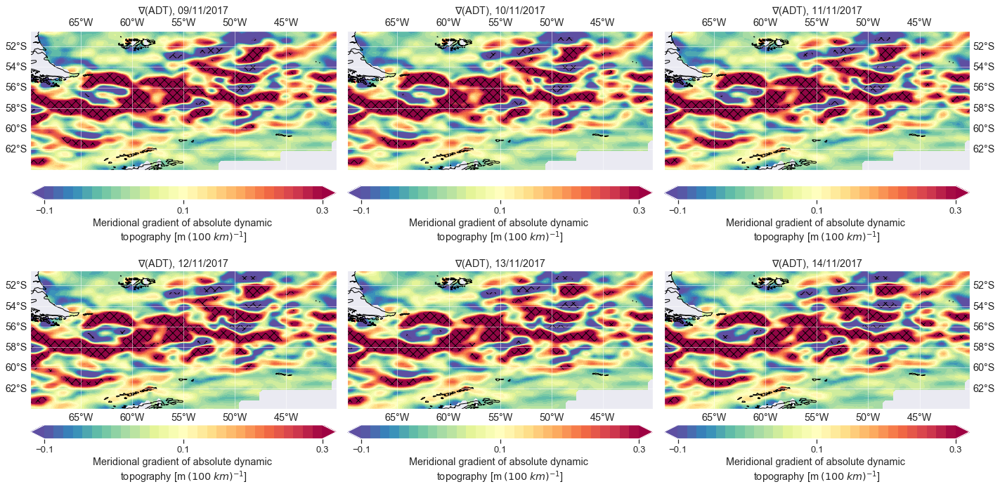

In [19]:
import matplotlib as mpl
fig = plt.figure(figsize=[20,10])

for i_day in np.arange(6):
    ax = plt.subplot(int('23'+str(i_day+1)), projection=ccrs.PlateCarree())
    X, Y= ds_adt_drake.longitude, ds_adt_drake.latitude
    Z = (ds_adt_drake.adt_grad_mer)[i_day]*100
    fronts = front_loc_drake[i_day]
    cs1 = ax.contourf(X, Y, Z,
        cmap='Spectral_r', 
        levels=np.linspace(-0.1,0.3,30), 
        vmin=-0.1,
        vmax=0.3, 
        center=0.1,
        #norm=mpl.colors.Normalize(vmin=-0.1, vmax=0.3),
        extend='both',
        transform=ccrs.PlateCarree())
    cbar = fig.colorbar(cs1, 
        orientation='horizontal', 
        pad=0.075,
        ticks=[-0.7,-0.5,-0.3,-0.1,0.1,0.3,0.5,0.7,0.9],
        label='Meridional gradient of absolute dynamic \ntopography [m $(100\:km)^{-1}$]')
    cs2= ax.contourf(X, Y, fronts, levels=2, hatches=['XX'], alpha = 0.2)

    ax.set_title(r'$\nabla$(ADT), ' + pd.to_datetime(str(ds_adt_drake.time[i_day].values)).strftime('%d/%m/%Y'))

    gl = ax.gridlines(alpha=0.5, draw_labels=True)
    if i_day+1 < 4:
        gl.bottom_labels = False
    else:
        gl.top_labels = False
    if i_day+1 == 2 or i_day+ 1 == 5:
        gl.left_labels = False
        gl.right_labels = False
    if i_day+1 == 1 or i_day+1 == 4:
        gl.right_labels = False
    if i_day+1 == 3 or i_day+1 == 6:
        gl.left_labels = False

    ax.coastlines()


fig.tight_layout()
plt.savefig(r'results\analysis\ADT_gradient_mer_drake_09-11_to_14-11.png', bbox_inches='tight', format='png')
plt.show()

In [20]:
for i_day in np.arange(5):
    print('day ' + str(i_day+1) + ' min = ' + str((ds_adt_drake.diff(dim='time').adt_grad_mer[i_day]*100).min().values))
    print('day ' + str(i_day+1) + ' max = ' + str((ds_adt_drake.diff(dim='time').adt_grad_mer[i_day]*100).max().values))

day 1 min = -0.2487874931987012
day 1 max = 0.20677156450053416
day 2 min = -0.17090045635097006
day 2 max = 0.15805795692493738
day 3 min = -0.14413092577015993
day 3 max = 0.16581961368332612
day 4 min = -0.1184252329800884
day 4 max = 0.09395828895318017
day 5 min = -0.20460035678578617
day 5 max = 0.12342141235992857


C:\Users\gian_\miniconda3\envs\mthesis\lib\site-packages\cartopy\mpl\geoaxes.py:1586: UserWarning: The following kwargs were not used by contour: 'center'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)
C:\Users\gian_\miniconda3\envs\mthesis\lib\site-packages\cartopy\mpl\geoaxes.py:1586: UserWarning: The following kwargs were not used by contour: 'center'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)
C:\Users\gian_\miniconda3\envs\mthesis\lib\site-packages\cartopy\mpl\geoaxes.py:1586: UserWarning: The following kwargs were not used by contour: 'center'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)
C:\Users\gian_\miniconda3\envs\mthesis\lib\site-packages\cartopy\mpl\geoaxes.py:1586: UserWarning: The following kwargs were not used by contour: 'center'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)
C:\Users\gian_\miniconda3\envs\mthesis\lib\site-packages\cartopy\mpl\geoaxes.py:1586: UserWarning: The following kwargs were

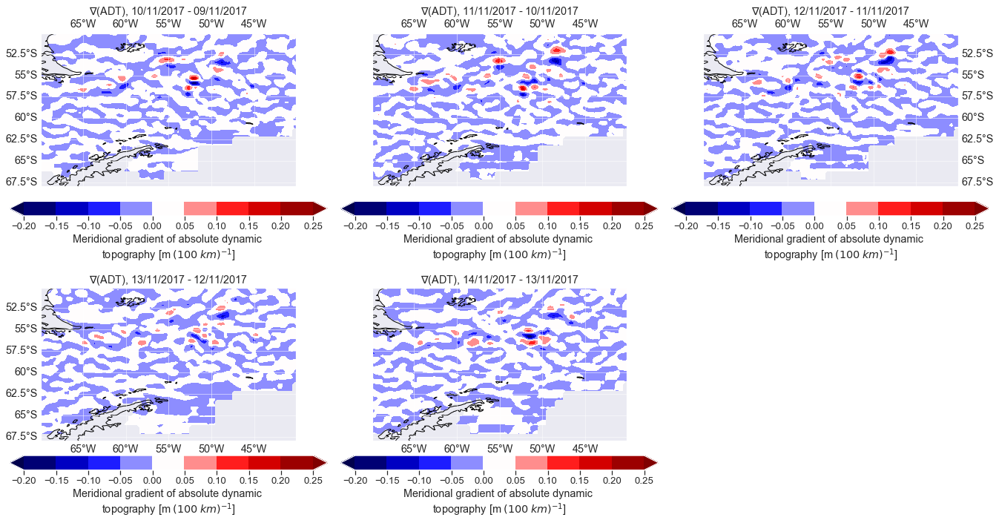

In [21]:
import matplotlib as mpl
fig = plt.figure(figsize=[20,10])

for i_day in np.arange(5):
    ax = plt.subplot(int('23'+str(i_day+1)), projection=ccrs.PlateCarree())
    X, Y= ds_adt_drake.longitude, ds_adt_drake.latitude
    Z = (ds_adt_drake.diff(dim='time').adt_grad_mer)[i_day]*100
    fronts = front_loc_drake[i_day]
    cs1 = ax.contourf(X, Y, Z,
        cmap='seismic', 
        levels=np.linspace(-0.2,0.25,10), 
        #vmin=-0.1,
        #vmax=0.3, 
        center=0.1,
        #norm=mpl.colors.Normalize(vmin=-0.1, vmax=0.3),
        extend='both',
        transform=ccrs.PlateCarree())
    cbar = fig.colorbar(cs1, 
        orientation='horizontal', 
        pad=0.075,
        #ticks=[-0.7,-0.5,-0.3,-0.1,0.1,0.3,0.5,0.7,0.9],
        label='Meridional gradient of absolute dynamic \ntopography [m $(100\:km)^{-1}$]')

    #cs2= ax.contourf(X, Y, fronts, levels=2, hatches=['XX'], alpha = 0.2)

    ax.set_title(r'$\nabla$(ADT), ' + pd.to_datetime(str(ds_adt_drake.time[i_day+1].values)).strftime('%d/%m/%Y') + ' - ' + pd.to_datetime(str(ds_adt_drake.time[i_day].values)).strftime('%d/%m/%Y'))

    gl = ax.gridlines(alpha=0.5, draw_labels=True)
    if i_day+1 < 4:
        gl.bottom_labels = False
    else:
        gl.top_labels = False
    if i_day+1 == 2 or i_day+ 1 == 5:
        gl.left_labels = False
        gl.right_labels = False
    if i_day+1 == 1 or i_day+1 == 4:
        gl.right_labels = False
    if i_day+1 == 3 or i_day+1 == 6:
        gl.left_labels = False

    ax.coastlines()


fig.tight_layout()
plt.savefig(r'results\analysis\ADT_gradient_mer_time_diff_drake_09-11_to_14-11.png', bbox_inches='tight', format='png')
plt.show()

In [24]:
ds_adt_mean = ds_adt.mean('time')

In [27]:
ds_adt_mean.adt.plot()